In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All"
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

In [2]:
from IPython.core.display import display, HTML, Javascript

html_contents ="""
    <!DOCTYPE html>
    <html lang="en">
        <head>
            <link rel="stylesheet" href="https://www.w3schools.com/w3css/4/w3.css">
            <link rel="stylesheet" href="https://fonts.googleapis.com/css?family=Raleway">
            <link rel="stylesheet" href="https://fonts.googleapis.com/css?family=Roboto">
            <link rel="stylesheet" href="https://fonts.googleapis.com/css?family=Verdana">
            <link rel="stylesheet" href="https://fonts.googleapis.com/css?family=Open Sans">
            <link rel="stylesheet" href="https://cdnjs.cloudflare.com/ajax/libs/font-awesome/4.7.0/css/font-awesome.min.css">
            <style>
            .title-section{
                font-family: "Roboto", Verdana, sans-serif;
                font-weight: bold;
                color: "#6A8CAF";
                letter-spacing: 6px;
            }
            hr { border: 1px solid #E58F65 !important;
                 color: #E58F65 !important;
                 background: #E58F65 !important;
               }
            body {
                font-family: "Verdana", sans-serif;
                }        
            </style>
        </head>    
    </html>
    """

HTML(html_contents)

/tmp/ipykernel_4052/2429941825.py:1: DeprecationWarning: Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display
  from IPython.core.display import display, HTML, Javascript


# <span class="title-section w3-xxlarge" style="color:#DC143C" id="codebook">0.NFL - National Football League - An Introduction </span>


| NFL Logo | NFL Team Locations |
| :---: | :-----: |
| ![NFL](https://upload.wikimedia.org/wikipedia/en/thumb/a/a2/National_Football_League_logo.svg/188px-National_Football_League_logo.svg.png) |   ![NFL Teams](https://upload.wikimedia.org/wikipedia/commons/thumb/e/e0/US_National_Football_League_Teams_Location-en.svg/500px-US_National_Football_League_Teams_Location-en.svg.png)   |





###### Some Info from Wikipedia
###### The National Football League (NFL) is a professional American football league consisting of 32 teams, divided equally between the National Football Conference (NFC) and the American Football Conference (AFC). The NFL is one of the four major North American professional sports leagues, the highest professional level of American football in the world.

###### The NFL's eighteen-week regular season runs from early September to early January, with each team playing seventeen games and having one bye week. Following the conclusion of the regular season, seven teams from each conference (four division winners and three wild card teams) advance to the playoffs, a single-elimination tournament culminating in the Super Bowl, which is usually held on the first Sunday in February and is played between the champions of the NFC and AFC. The league is headquartered in New York City.

###### The NFL was formed in 1920 as the American Professional Football Association (APFA) before renaming itself the National Football League for the 1922 season. After initially determining champions through end-of-season standings, a playoff system was implemented in 1933 that culminated with the NFL Championship Game until 1966. Following an agreement to merge the NFL with the rival American Football League (AFL), the Super Bowl was first held in 1967 to determine a champion between the best teams from the two leagues and has remained as the final game of each NFL season since the merger was completed in 1970.

###### Today,the NFL has the highest average attendance (67,591) of any professional sports league in the world and is the most popular sports league in the United States. The Super Bowl is also among the biggest club sporting events in the world, with the individual games accounting for many of the most watched television programs in American history and all occupying the Nielsen's Top 5 tally of the all-time most watched U.S. television broadcasts by 2015. The NFL is the wealthiest professional sports league by revenue, and the sports league with the most valuable teams.

# <span class="title-section w3-xxlarge" style="color:#DC143C" id="codebook">1.Load the Libraries </span>


In [3]:
import seaborn as sns
import plotly.express as px
import matplotlib.pyplot as plt


In [4]:
plays = '/data/elastic-notebook/data/nfl-big-data-bowl-2023/plays.csv'
plays_df = pd.read_csv(plays)
plays_df

,gameId,playId,playDescription,quarter,down,yardsToGo,possessionTeam,defensiveTeam,yardlineSide,yardlineNumber,...,foulNFLId3,absoluteYardlineNumber,offenseFormation,personnelO,defendersInBox,personnelD,dropBackType,pff_playAction,pff_passCoverage,pff_passCoverageType
0,2021090900,97,(13:33) (Shotgun) T.Brady pass incomplete deep...,1,3,2,TB,DAL,TB,33,...,NaN,43.0,SHOTGUN,"1 RB, 1 TE, 3 WR",6.0,"4 DL, 2 LB, 5 DB",TRADITIONAL,0,Cover-1,Man
1,2021090900,137,(13:18) (Shotgun) D.Prescott pass deep left to...,1,1,10,DAL,TB,DAL,2,...,NaN,108.0,EMPTY,"1 RB, 2 TE, 2 WR",6.0,"4 DL, 4 LB, 3 DB",TRADITIONAL,0,Cover-3,Zone
2,2021090900,187,(12:23) (Shotgun) D.Prescott pass short middle...,1,2,6,DAL,TB,DAL,34,...,NaN,76.0,SHOTGUN,"0 RB, 2 TE, 3 WR",6.0,"3 DL, 3 LB, 5 DB",TRADITIONAL,0,Cover-3,Zone
3,2021090900,282,(9:56) D.Prescott pass incomplete deep left to...,1,1,10,DAL,TB,TB,39,...,NaN,49.0,SINGLEBACK,"1 RB, 2 TE, 2 WR",6.0,"4 DL, 3 LB, 4 DB",TRADITIONAL,1,Cover-3,Zone
4,2021090900,349,(9:46) (Shotgun) D.Prescott pass incomplete sh...,1,3,15,DAL,TB,TB,44,...,NaN,54.0,SHOTGUN,"1 RB, 1 TE, 3 WR",7.0,"3 DL, 4 LB, 4 DB",TRADITIONAL,0,Cover-3,Zone
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8553,2021110100,4310,(1:56) (Shotgun) P.Mahomes sacked at NYG 16 fo...,4,3,8,KC,NYG,NYG,8,...,NaN,18.0,SHOTGUN,"1 RB, 1 TE, 3 WR",4.0,"1 DL, 3 LB, 7 DB",SCRAMBLE,0,Bracket,Other
8554,2021110100,4363,(1:07) (Shotgun) D.Jones pass short right to E...,4,1,10,NYG,KC,NYG,25,...,NaN,35.0,SHOTGUN,"1 RB, 1 TE, 3 WR",5.0,"4 DL, 1 LB, 6 DB",SCRAMBLE,0,Cover-2,Zone
8555,2021110100,4392,"(1:01) (No Huddle, Shotgun) D.Jones sacked at ...",4,2,7,NYG,KC,NYG,28,...,NaN,38.0,SHOTGUN,"1 RB, 1 TE, 3 WR",6.0,"4 DL, 1 LB, 6 DB",TRADITIONAL,0,Cover-2,Zone
8556,2021110100,4411,"(:39) (No Huddle, Shotgun) D.Jones pass incomp...",4,3,15,NYG,KC,NYG,20,...,NaN,30.0,SHOTGUN,"1 RB, 1 TE, 3 WR",5.0,"4 DL, 1 LB, 6 DB",TRADITIONAL,0,Cover-2,Zone


# <span class="title-section w3-xxlarge" style="color:#DC143C" id="codebook">2.Check the Datasets </span>


In [5]:
def disp(data,num):
    print(data.shape)
    print(data.columns)
    print("*"*num)
    print(data.describe())
    print("="*num)
    return data.head(num)

In [6]:
print(disp(plays_df,20))

(8558, 32)
Index(['gameId', 'playId', 'playDescription', 'quarter', 'down', 'yardsToGo',
       'possessionTeam', 'defensiveTeam', 'yardlineSide', 'yardlineNumber',
       'gameClock', 'preSnapHomeScore', 'preSnapVisitorScore', 'passResult',
       'penaltyYards', 'prePenaltyPlayResult', 'playResult', 'foulName1',
       'foulNFLId1', 'foulName2', 'foulNFLId2', 'foulName3', 'foulNFLId3',
       'absoluteYardlineNumber', 'offenseFormation', 'personnelO',
       'defendersInBox', 'personnelD', 'dropBackType', 'pff_playAction',
       'pff_passCoverage', 'pff_passCoverageType'],
      dtype='object')
********************
             gameId       playId      quarter         down    yardsToGo  \
count  8.558000e+03  8558.000000  8558.000000  8558.000000  8558.000000   
mean   2.021098e+09  2159.114162     2.617901     1.966698     8.724235   
std    4.971956e+03  1222.758114     1.132278     0.872864     3.912852   
min    2.021091e+09    54.000000     1.000000     0.000000     0.000000   

In [7]:
plays_df.fillna(0)

,gameId,playId,playDescription,quarter,down,yardsToGo,possessionTeam,defensiveTeam,yardlineSide,yardlineNumber,...,foulNFLId3,absoluteYardlineNumber,offenseFormation,personnelO,defendersInBox,personnelD,dropBackType,pff_playAction,pff_passCoverage,pff_passCoverageType
0,2021090900,97,(13:33) (Shotgun) T.Brady pass incomplete deep...,1,3,2,TB,DAL,TB,33,...,0.0,43.0,SHOTGUN,"1 RB, 1 TE, 3 WR",6.0,"4 DL, 2 LB, 5 DB",TRADITIONAL,0,Cover-1,Man
1,2021090900,137,(13:18) (Shotgun) D.Prescott pass deep left to...,1,1,10,DAL,TB,DAL,2,...,0.0,108.0,EMPTY,"1 RB, 2 TE, 2 WR",6.0,"4 DL, 4 LB, 3 DB",TRADITIONAL,0,Cover-3,Zone
2,2021090900,187,(12:23) (Shotgun) D.Prescott pass short middle...,1,2,6,DAL,TB,DAL,34,...,0.0,76.0,SHOTGUN,"0 RB, 2 TE, 3 WR",6.0,"3 DL, 3 LB, 5 DB",TRADITIONAL,0,Cover-3,Zone
3,2021090900,282,(9:56) D.Prescott pass incomplete deep left to...,1,1,10,DAL,TB,TB,39,...,0.0,49.0,SINGLEBACK,"1 RB, 2 TE, 2 WR",6.0,"4 DL, 3 LB, 4 DB",TRADITIONAL,1,Cover-3,Zone
4,2021090900,349,(9:46) (Shotgun) D.Prescott pass incomplete sh...,1,3,15,DAL,TB,TB,44,...,0.0,54.0,SHOTGUN,"1 RB, 1 TE, 3 WR",7.0,"3 DL, 4 LB, 4 DB",TRADITIONAL,0,Cover-3,Zone
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8553,2021110100,4310,(1:56) (Shotgun) P.Mahomes sacked at NYG 16 fo...,4,3,8,KC,NYG,NYG,8,...,0.0,18.0,SHOTGUN,"1 RB, 1 TE, 3 WR",4.0,"1 DL, 3 LB, 7 DB",SCRAMBLE,0,Bracket,Other
8554,2021110100,4363,(1:07) (Shotgun) D.Jones pass short right to E...,4,1,10,NYG,KC,NYG,25,...,0.0,35.0,SHOTGUN,"1 RB, 1 TE, 3 WR",5.0,"4 DL, 1 LB, 6 DB",SCRAMBLE,0,Cover-2,Zone
8555,2021110100,4392,"(1:01) (No Huddle, Shotgun) D.Jones sacked at ...",4,2,7,NYG,KC,NYG,28,...,0.0,38.0,SHOTGUN,"1 RB, 1 TE, 3 WR",6.0,"4 DL, 1 LB, 6 DB",TRADITIONAL,0,Cover-2,Zone
8556,2021110100,4411,"(:39) (No Huddle, Shotgun) D.Jones pass incomp...",4,3,15,NYG,KC,NYG,20,...,0.0,30.0,SHOTGUN,"1 RB, 1 TE, 3 WR",5.0,"4 DL, 1 LB, 6 DB",TRADITIONAL,0,Cover-2,Zone


# <span class="title-section w3-xlarge" style="color:#DC143C" id="codebook">2.1.Let us do some basic EDA Using DataPrep </span>


In [8]:
from dataprep.datasets import load_dataset
from dataprep.eda import create_report
from dataprep.eda import plot, plot_correlation, plot_missing

In [9]:
create_report(plays_df).show_browser()

  0%|                                                                                                         …

/home/zl20/venv/lib/python3.8/site-packages/dataprep/eda/distribution/render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({col: [nrows - npresent]}, index=["Others"]))
/home/zl20/venv/lib/python3.8/site-packages/dataprep/eda/distribution/render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({col: [nrows - npresent]}, index=["Others"]))
/home/zl20/venv/lib/python3.8/site-packages/dataprep/eda/distribution/render.py:274: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  df = df.append(pd.DataFrame({col: [nrows - npresent]}, index=["Others"]))
/home/zl20/venv/lib/python3.8/site-packages/dataprep/eda/distribution/render.py:274: FutureWarning: The frame.append m

  0%|                                                                                                         …


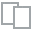
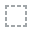
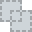
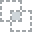
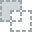
...
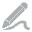
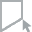
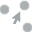
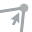
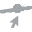

In [10]:
plot(plays_df)


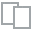
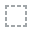
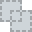
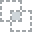
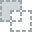
...
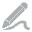
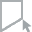
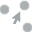
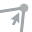
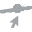

In [11]:
plot_correlation(plays_df)

  0%|                                                                                                         …


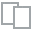
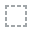
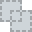
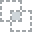
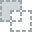
...
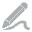
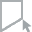
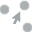
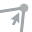
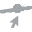

In [12]:
plot_missing(plays_df)

# <span class="title-section w3-xxlarge" style="color:#DC143C" id="codebook">3.Let us do some basic Visualization using Matplotlib and Seaborn </span>


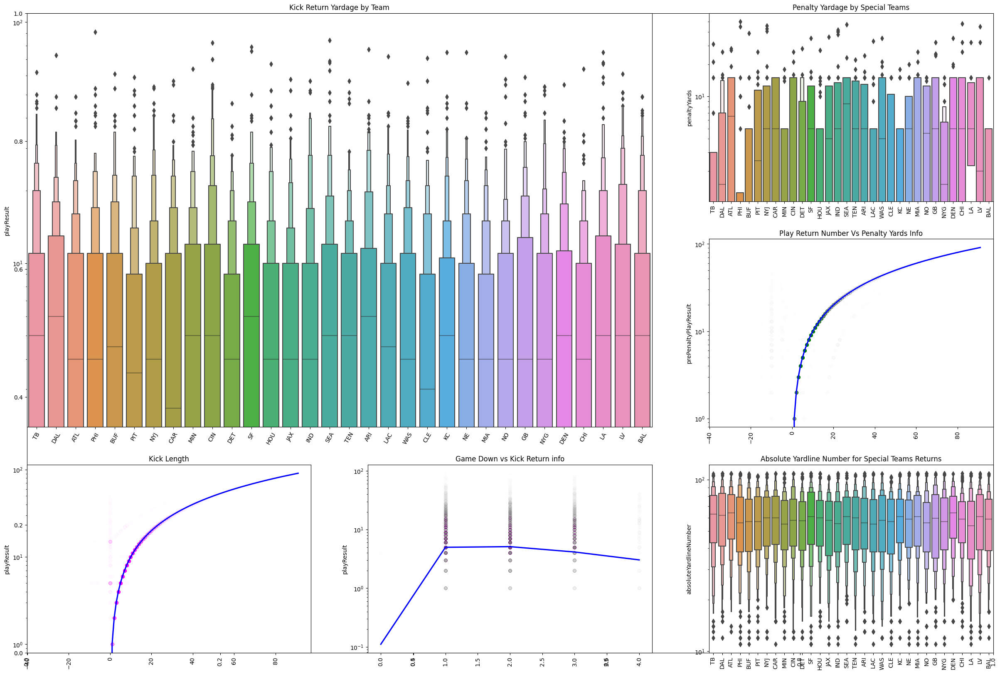

In [13]:
# Import necessary auxiliary stuffs
from matplotlib import gridspec, ticker

# Define size and grid spec
fig = plt.figure(figsize=(30, 20), constrained_layout=False)
gs = gridspec.GridSpec(3, 3, figure=fig)
plt.xticks(rotation=90)

# Make plot to put in first row, rightmost column
ax = fig.add_subplot(gs[1, 2])
sns.regplot(data = plays_df, x = 'playResult', y = 'prePenaltyPlayResult',
            ax = ax, lowess = True,
            scatter_kws = {'alpha': 0.005, 'color': 'green'},
            line_kws = {'color': 'blue'}) \
    .set_yscale('log')

ax.set(title = 'Play Return Number Vs Penalty Yards Info', xlabel = None)

plt.xticks(rotation=90)

# Make plot to put in second row, rightmost column
ax = fig.add_subplot(gs[0, 2])
sns.boxenplot(data = plays_df, x = 'possessionTeam', y = 'penaltyYards', ax = ax) \
    .set_yscale('log')
ax.set(title = 'Penalty Yardage by Special Teams', xlabel = None)
plt.xticks(rotation=90)

# Make plot to put in third row, rightmost column
ax = fig.add_subplot(gs[2, 2])
sns.boxenplot(data = plays_df, x = 'possessionTeam', y = 'absoluteYardlineNumber', ax = ax) \
    .set_yscale('log')
ax.set(title = 'Absolute Yardline Number for Special Teams Returns', xlabel = None)
plt.xticks(rotation=90)

# Make plot to put in third row, center column
ax = fig.add_subplot(gs[2, 0])
sns.regplot(data = plays_df, y = 'playResult', x = 'prePenaltyPlayResult',
            ax = ax, lowess = True,
            scatter_kws = {'alpha': 0.005, 'color': 'magenta'},
            line_kws = {'color': 'blue'}) \
    .set_yscale('log')
ax.set(title = 'Kick Length', xlabel = None)
plt.xticks(rotation=90)

# Make plot to put in third row, leftmost column
ax = fig.add_subplot(gs[2, 1])
sns.regplot(data = plays_df, x = 'down', y = 'playResult',
            ax = ax, lowess = True,
            scatter_kws = {'alpha': 0.005, 'color': 'purple'},
            line_kws = {'color': 'blue'}) \
    .set_yscale('log')
ax.set(title = 'Game Down vs Kick Return info', xlabel = None)
plt.xticks(rotation=90)

# Make plot that spans the remaining grid
ax = fig.add_subplot(gs[0:2, 0:2])
sns.boxenplot(data = plays_df, x = 'possessionTeam', y = 'playResult', ax = ax) \
    .set_yscale('log')
ax.set(title = 'Kick Return Yardage by Team', xlabel = None)
plt.xticks(rotation=60)

plt.show()

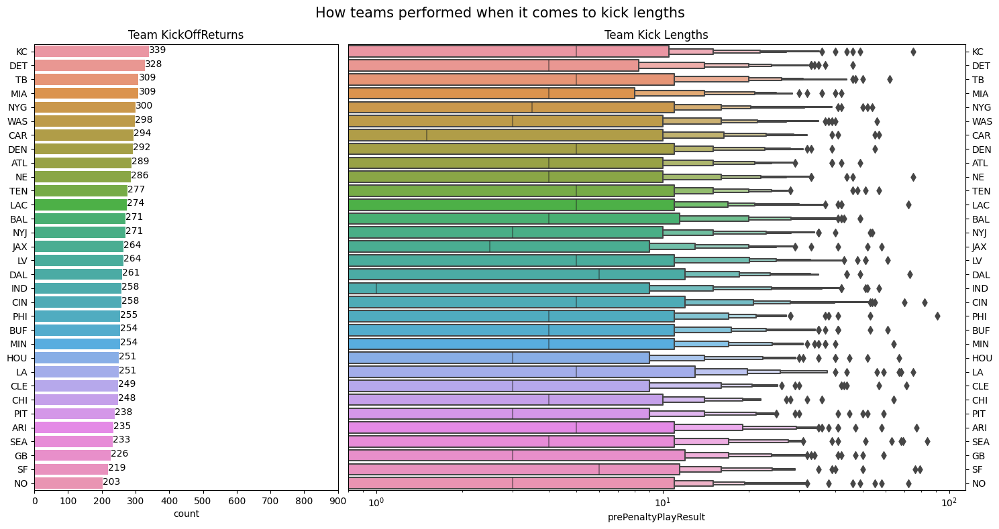

In [14]:
color_counts = (plays_df['possessionTeam'].value_counts().reset_index())
color_counts.columns = ['possessionTeam', 'count']

order = color_counts['possessionTeam']
palette = color_counts['possessionTeam'].replace('other', None) # "other" is not a color name

fig = plt.figure(figsize=(15, 8))
gs = gridspec.GridSpec(1, 3, figure=fig)

# Left plot
ax = fig.add_subplot(gs[0])
sns.barplot(data = color_counts, x = 'count', y = 'possessionTeam',
            #palette = palette, 
            ax = ax)
ax.set(title = 'Team KickOffReturns')
ax.set_xlim((0, 900))
for p in ax.patches:
    ax.annotate(f"{int(p.get_width())}", xy = (p.get_width(), p.get_y() + 0.5),
                horizontalalignment = 'left')
    clr = p.get_facecolor()
    if clr == (1, 1, 1, 1):
        # If facecolor is white
        p.set_edgecolor('magenta')
ax.set_ylabel('')


# Right plot
ax = fig.add_subplot(gs[1:3])
sns.boxenplot(data = plays_df, x = 'prePenaltyPlayResult', y = 'possessionTeam',
              order = order, 
              #palette = palette, 
              ax = ax)
ax.set(title = 'Team Kick Lengths', xscale = 'log')
ax.yaxis.tick_right()
ax.set_ylabel('')

plt.suptitle("How teams performed when it comes to kick lengths", fontsize = 15)
plt.tight_layout()
plt.show()

 

In [15]:
df_temp = pd.DataFrame(plays_df.groupby(['offenseFormation']).playResult.count())
df_temp2 = pd.DataFrame(plays_df.groupby(['playResult']).playResult.count())
df_temp3= pd.DataFrame(plays_df.groupby(['offenseFormation', 'playResult']).count()).reset_index()
df_temp=df_temp.rename(columns={"playResult": "playResult"})
df_temp2=df_temp2.rename(columns={"playResult": "playResult"})
df_temp=df_temp.fillna(0)

## <span class="title-section w3-xlarge" style="color:#DC143C" id="codebook">4.1.Some Plots based on Number of Special Team plays </span>


</span>


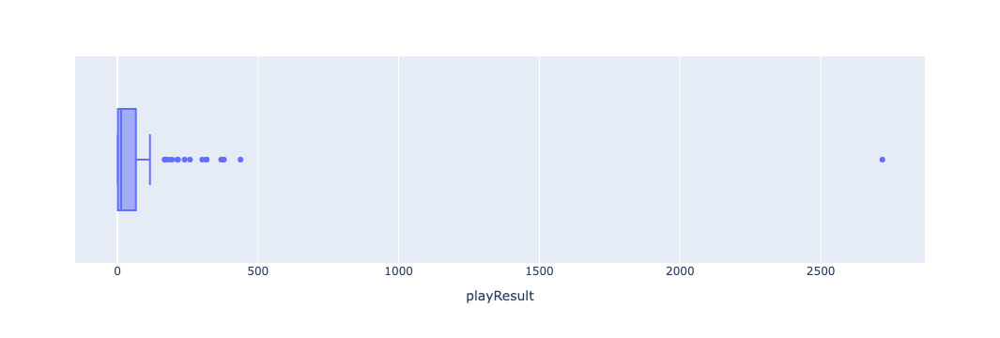

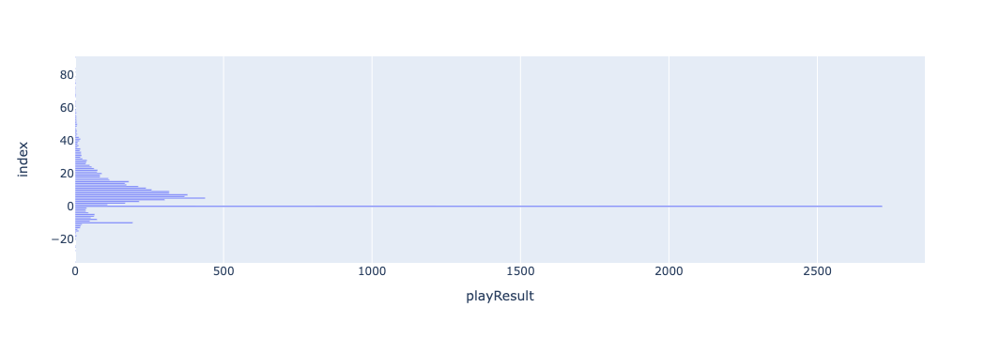

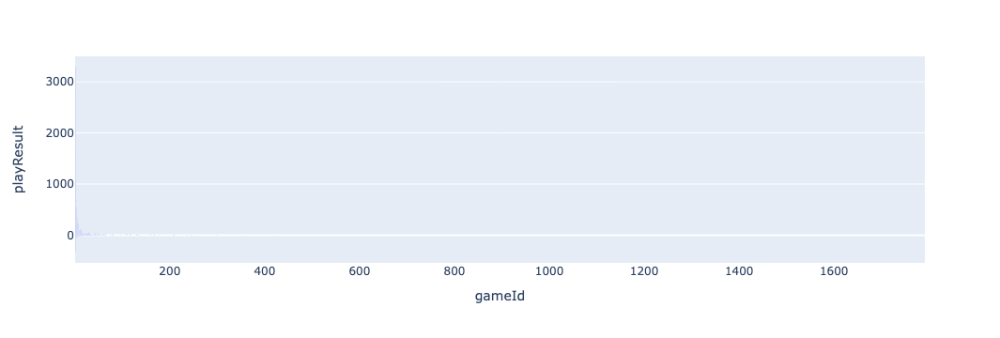

In [16]:
fig = px.box(df_temp2, x="playResult")
fig.show()
fig = px.bar(df_temp2, x="playResult")
fig.show()
fig = px.bar(df_temp3.sort_values('gameId',ascending=False), x='gameId', y='playResult')#, color='playDescription')
fig.show()
fig = px.bar(df_temp3.sort_values('gameId',ascending=False), x='gameId', y='playResult', color='playDescription')

 

In [17]:
del df_temp
del df_temp3
del df_temp2

## <span class="title-section w3-xlarge" style="color:#DC143C" id="codebook">4.3.Some Plots based on Number of Special Team Kick Return Yardage </span>


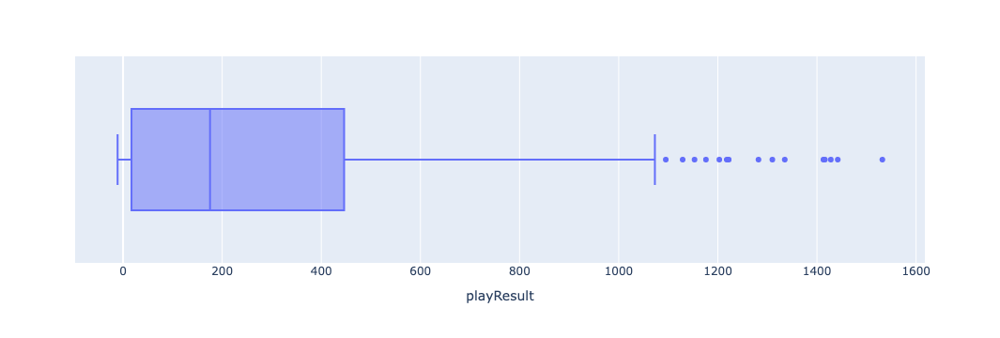

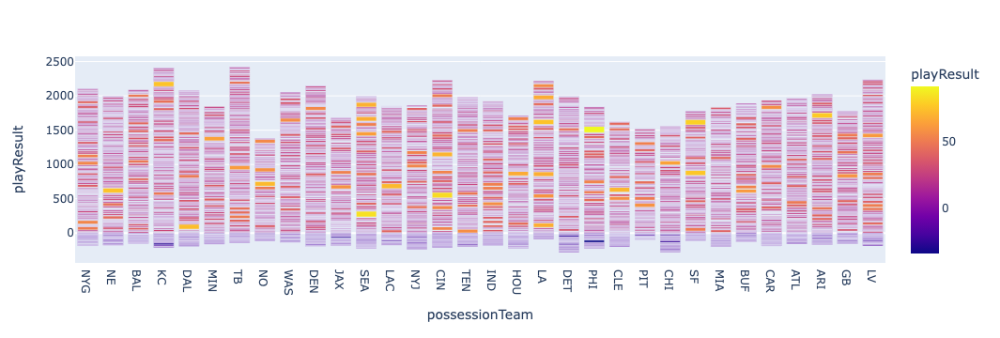

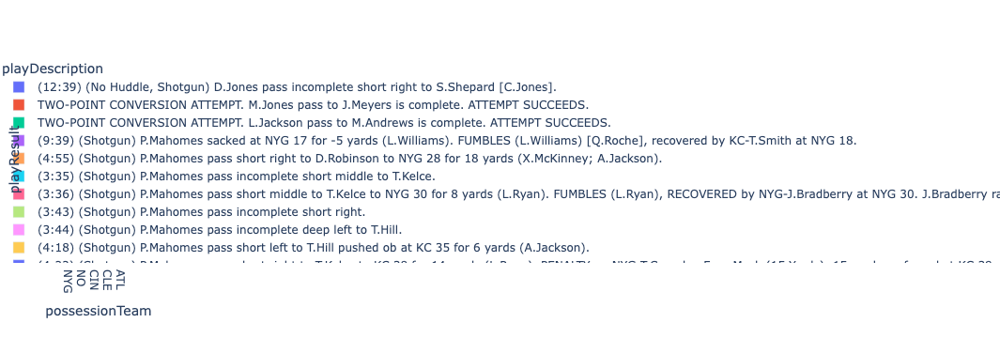

In [18]:
df_temp = pd.DataFrame(plays_df.groupby(['possessionTeam','offenseFormation']).playResult.sum())
df_temp2 = pd.DataFrame(plays_df.groupby(['possessionTeam','offenseFormation']).playResult.sum())
df_temp3= pd.DataFrame(plays_df.groupby(['possessionTeam','playDescription', 'playResult']).sum()).reset_index()
df_temp=df_temp.fillna(0)
fig = px.box(df_temp2, x="playResult")
fig.show()
fig = px.bar(df_temp3.sort_values('gameId',ascending=False), x="possessionTeam", y="playResult" , color='playResult')
fig.show()
fig = px.bar(df_temp3.sort_values('gameId',ascending=False), x="possessionTeam", y="playResult" , color='playDescription')
fig.show()
del df_temp
del df_temp3
del df_temp2
 

## <span class="title-section w3-xlarge" style="color:#DC143C" id="codebook">4.4.Statistics based on absoluteYardlineNumber of each team and special team actions </span>


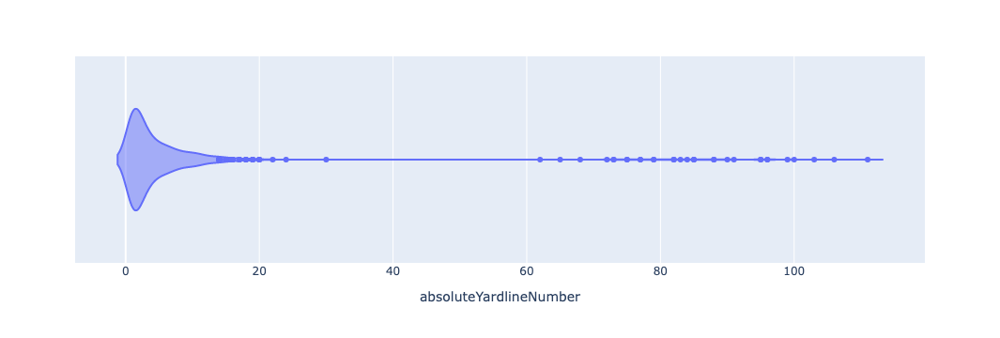

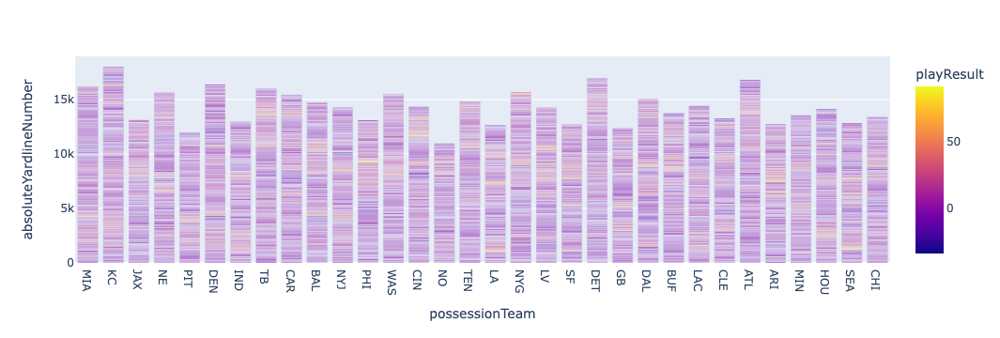

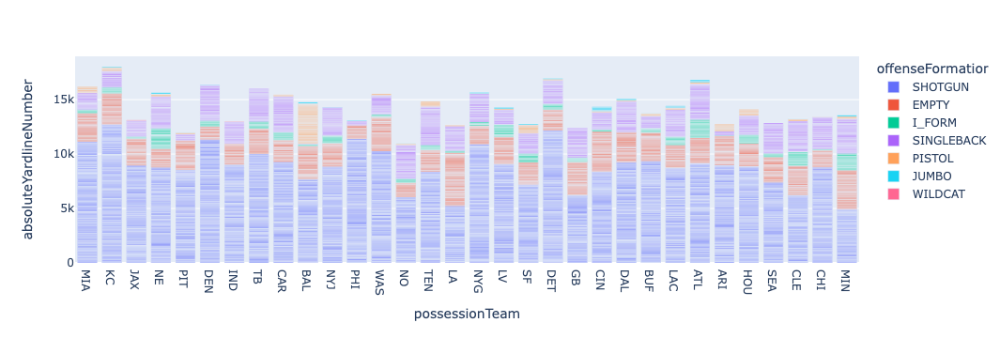

In [19]:
df_temp = pd.DataFrame(plays_df.groupby(['possessionTeam','offenseFormation']).absoluteYardlineNumber.count())
df_temp2 = pd.DataFrame(plays_df.groupby(['possessionTeam','playResult']).absoluteYardlineNumber.count())
df_temp3= pd.DataFrame(plays_df.groupby(['possessionTeam','offenseFormation', 'playResult','absoluteYardlineNumber']).count()).reset_index()
df_temp=df_temp.fillna(0)
fig = px.violin(df_temp2, x="absoluteYardlineNumber")
fig.show()
fig = px.bar(df_temp3.sort_values('gameId',ascending=False), x="possessionTeam", y="absoluteYardlineNumber" , color='playResult')
fig.show()
fig = px.bar(df_temp3.sort_values('gameId',ascending=False), x="possessionTeam", y="absoluteYardlineNumber" , color='offenseFormation')
fig.show()
del df_temp
del df_temp3
del df_temp2

 

## <span class="title-section w3-xlarge" style="color:#DC143C" id="codebook">4.5.Some Plots based on Number of Special Team Penalty Yards Impact </span>


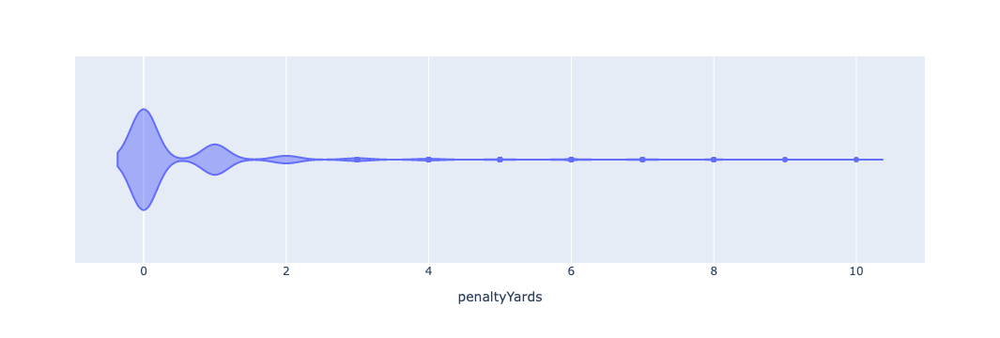

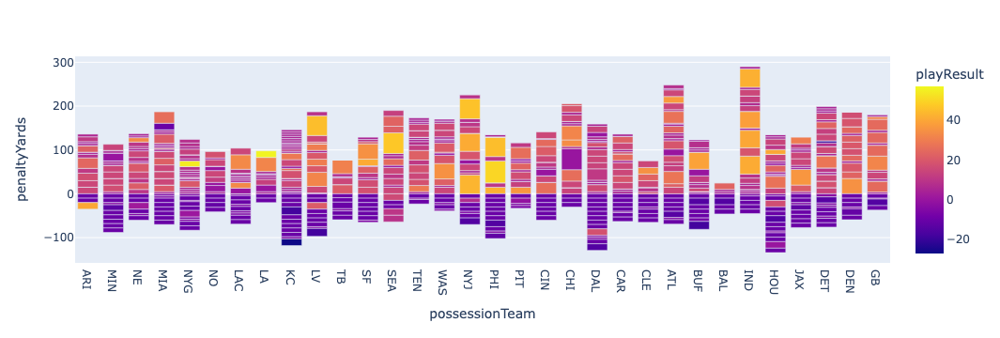

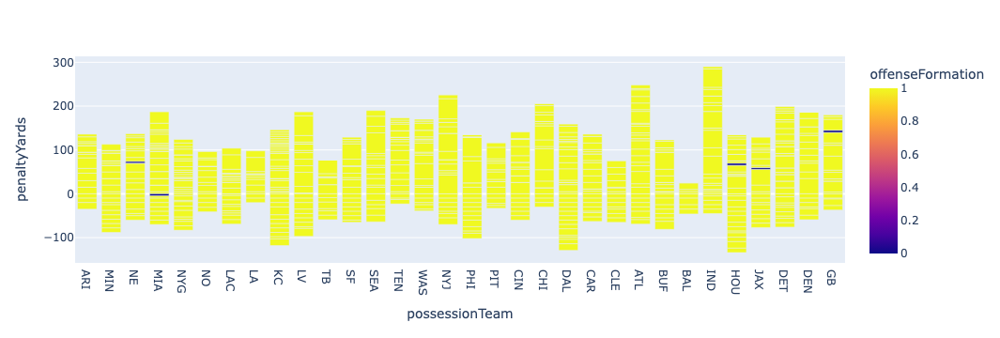

In [20]:
df_temp = pd.DataFrame(plays_df.groupby(['possessionTeam','offenseFormation']).penaltyYards.count())
df_temp2 = pd.DataFrame(plays_df.groupby(['possessionTeam','playResult']).penaltyYards.count())
df_temp3= pd.DataFrame(plays_df.groupby(['possessionTeam','playDescription', 'playResult','penaltyYards']).count()).reset_index()
df_temp=df_temp.fillna(0)
fig = px.violin(df_temp2, x="penaltyYards")
fig.show()
fig = px.bar(df_temp3.sort_values('gameId',ascending=False), x="possessionTeam", y="penaltyYards" , color='playResult')
fig.show()
fig = px.bar(df_temp3.sort_values('gameId',ascending=False), x="possessionTeam", y="penaltyYards" , color='offenseFormation')
fig.show()
del df_temp
del df_temp3
del df_temp2

 


## <span class="title-section w3-xlarge" style="color:#DC143C" id="codebook">4.6 Let us try some seaborn Pair Plot Charts </span>



## <span class="title-section w3-large" style="color:#DC143C" id="codebook">4.6.1 Full seaborn Pair Plot Charts </span>


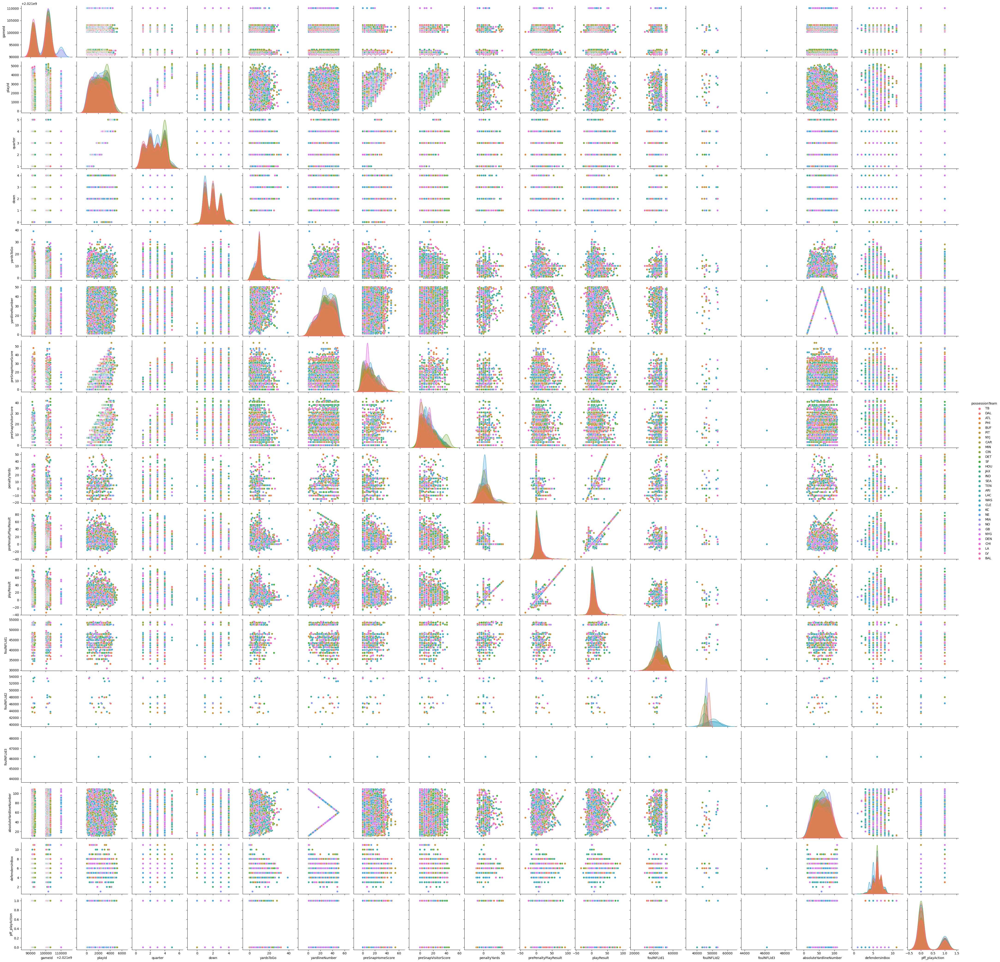

In [21]:
sns.pairplot(plays_df, hue="possessionTeam")



## <span class="title-section w3-large" style="color:#DC143C" id="codebook">4.6.3 Full seaborn Pair Plot Chart with a hue on Possession Time </span>


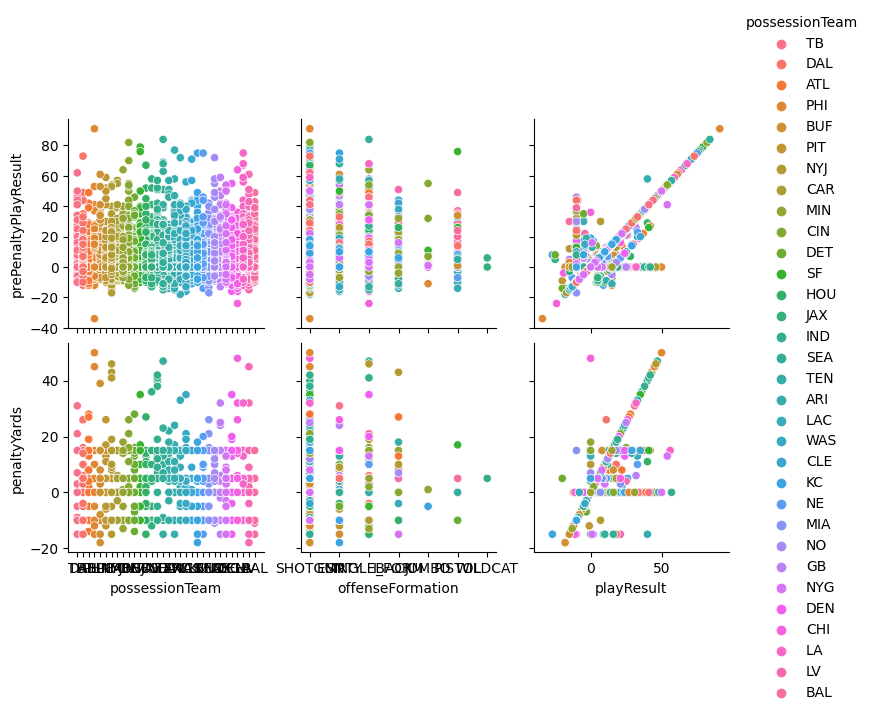

In [22]:
sns.pairplot(
    plays_df,
    x_vars=["possessionTeam", "offenseFormation", "playResult"],
    y_vars=["prePenaltyPlayResult", "penaltyYards"],
    hue='possessionTeam',)




## <span class="title-section w3-xlarge" style="color:#DC143C" id="codebook">4.7 A FacetGrid Plot </span>


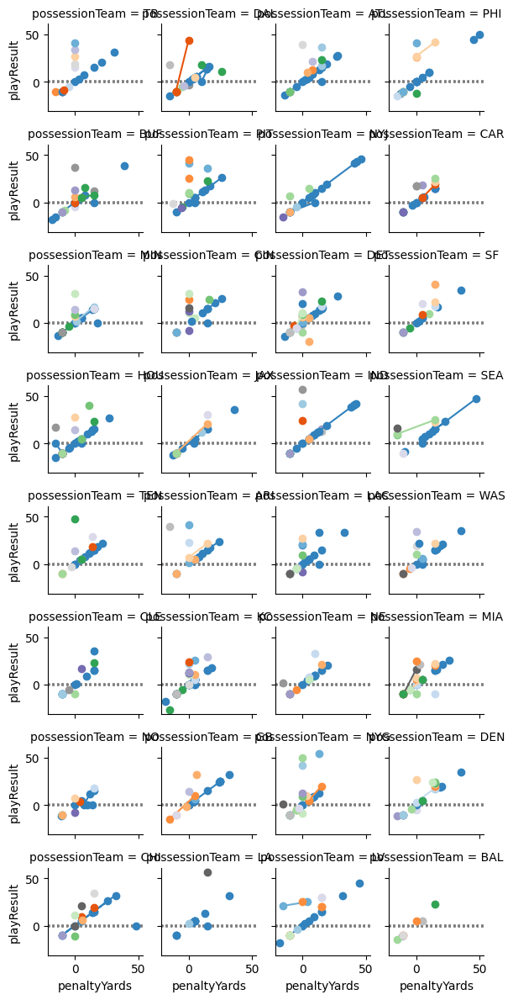

In [23]:
# Initialize a grid of plots with an Axes for each walk
grid = sns.FacetGrid(plays_df, col="possessionTeam", hue="prePenaltyPlayResult", palette="tab20c",
                     col_wrap=4, height=1.5)

# Draw a horizontal line to show the starting point
grid.refline(y=0, linestyle=":")

# Draw a line plot to show the trajectory of each random walk
grid.map(plt.plot, "penaltyYards", "playResult", marker="o")

# Adjust the arrangement of the plots
grid.fig.tight_layout(w_pad=1)

 


## <span class="title-section w3-xlarge" style="color:#DC143C" id="codebook">4.8 Let us plot some playes from Week 1 play dataset </span>


### <span class="title-section w3-large" style="color:#DC143C" id="codebook">4.8.1 Let us load the plays dataset </span>

In [24]:
tr_2018 = '/data/elastic-notebook/data/nfl-big-data-bowl-2023/week1.csv'
tracking2018 = pd.read_csv(tr_2018)


### <span class="title-section w3-large" style="color:#DC143C" id="codebook">4.8.2 Let us plot the football field </span>

In [25]:
#football field - code from  https://www.kaggle.com/jaronmichal/tracking-data-visualization
import matplotlib.patches as patches
from matplotlib.patches import Arc
from matplotlib import pyplot as plt
import matplotlib.patches as mpatches

# Change size of the figure
plt.rcParams['figure.figsize'] = [24, 16]
def drawPitch(width, height, color="w"):
    fig = plt.figure()
    ax = plt.axes(xlim=(-10, width + 30), ylim=(-15, height + 5))
    plt.axis('off')

    # Grass around pitch
    rect = patches.Rectangle((-10, -5), width + 40, height + 10, linewidth=1, facecolor='#3f995b', capstyle='round')
    ax.add_patch(rect)
    ###################

    # Pitch boundaries
    rect = plt.Rectangle((0, 0), width + 20, height, ec=color, fc="None", lw=2)
    ax.add_patch(rect)
    ###################

    # vertical lines - every 5 yards
    for i in range(21):
        plt.plot([10 + 5 * i, 10 + 5 * i], [0, height], c="w", lw=2)
    ###################
        
    # distance markers - every 10 yards
    for yards in range(10, width, 10):
        yards_text = yards if yards <= width / 2 else width - yards
        # top markers
        plt.text(10 + yards - 2, height - 7.5, yards_text, size=15, c="w", weight="bold")
        # botoom markers
        plt.text(10 + yards - 2, 7.5, yards_text, size=15, c="w", weight="bold", rotation=180)
    ###################

    # yards markers - every yard
    # bottom markers
    for x in range(20):
        for j in range(1, 5):
            plt.plot([10 + x * 5 + j, 10 + x * 5 + j], [1, 3], color="w", lw=2)

    # top markers
    for x in range(20):
        for j in range(1, 5):
            plt.plot([10 + x * 5 + j, 10 + x * 5 + j], [height - 1, height - 3], color="w", lw=2)

    # middle bottom markers
    y = (height - 18.5) / 2
    for x in range(20):
        for j in range(1, 5):
            plt.plot([10 + x * 5 + j, 10 + x * 5 + j], [y, y + 2], color="w", lw=2)

    # middle top markers
    for x in range(20):
        for j in range(1, 5):
            plt.plot([10 + x * 5 + j, 10 + x * 5 + j], [height - y, height - y - 2], color="w", lw=2)
    ###################

    # draw home end zone
    plt.text(2.5, (height - 15) / 2, "HOME", size=30, c="w", weight="bold", rotation=90)
    rect = plt.Rectangle((0, 0), 10, height, ec=color, fc="#0064dc", lw=2)
    ax.add_patch(rect)

    # draw away end zone    
    plt.text(111, (height - 15) / 2, "AWAY", size=30, c="w", weight="bold", rotation=-90)
    rect = plt.Rectangle((width + 10, 0), 10, height, ec=color, fc="#c80014", lw=2)
    ax.add_patch(rect)
    ###################
    
    # draw extra spot point
    # left
    y = (height - 3) / 2
    plt.plot([10 + 2, 10 + 2], [y, y + 3], c="w", lw=2)
    
    # right
    plt.plot([width + 10 - 2, width + 10 - 2], [y, y + 3], c="w", lw=2)
    ###################
    
    # draw goalpost
    goal_width = 6 # yards
    y = (height - goal_width) / 2
    # left
    plt.plot([0, 0], [y, y + goal_width], "-", c="y", lw=10, ms=20)
    # right
    plt.plot([width + 20, width + 20], [y, y + goal_width], "-", c="y", lw=10, ms=20)
    
    return fig, ax


### <span class="title-section w3-large" style="color:#DC143C" id="codebook">4.8.3 Plot a play for different roles</span>

In [26]:
from cycler import cycler
custom_cycler = (cycler(color=['b','k','m','g']))

In [27]:
def plot_play(df, gameId, position):
    fig, ax = drawPitch(100, 54)
    ax.set_prop_cycle(custom_cycler)
    df.query('gameId == ' + gameId ).groupby('team').plot(x='x', y='y', ax=ax, style='.')
    plt.title(' Plotting for gameId == ' + gameId ,fontsize=36,ha='center')
    plt.legend().remove()

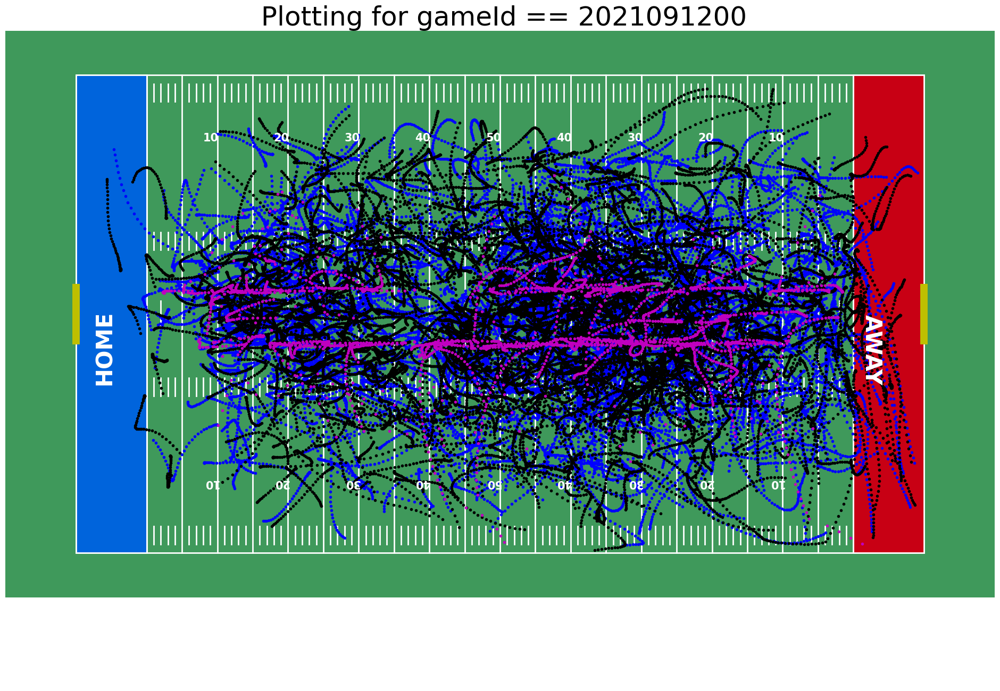

In [28]:
#poslist = ["CB","OLB","WR","RB","TE","LB","ILB","K","P"]
#for position in poslist:
    #print('Plotting for a ' + position + ' Postion performance')
position="QB"
plot_play(tracking2018,'2021091200', position)

### <span class="title-section w3-medium" style="color:#DC143C" id="codebook">4.8.3.1 Plot a play for Running Backs</span>

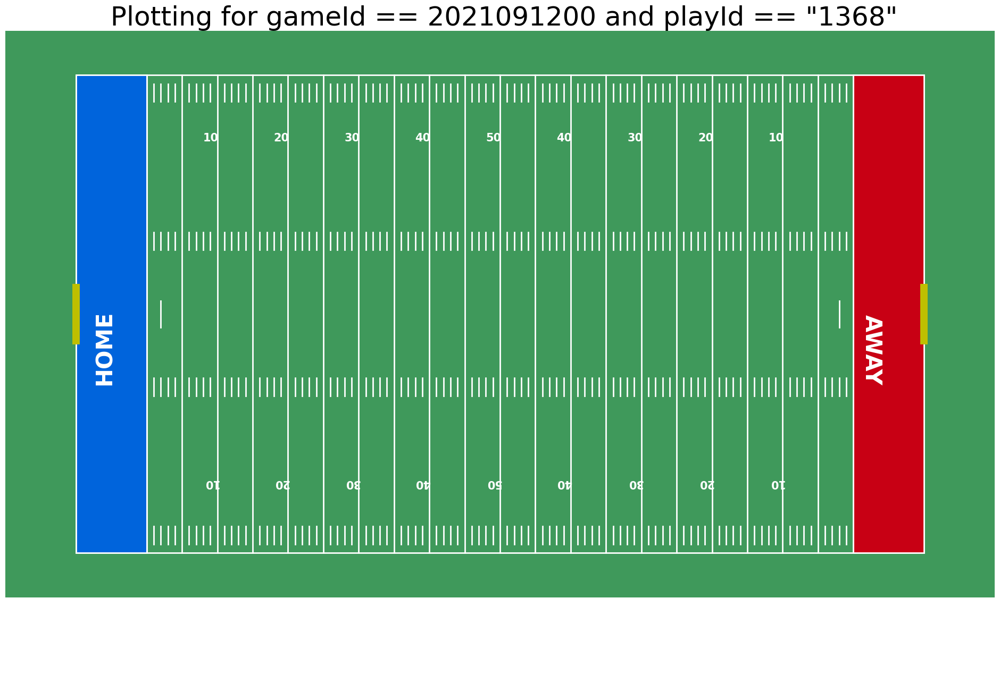

In [29]:
#fig, ax = plt.subplots(figsize=(12, 8))
fig, ax = drawPitch(100, 54)
ax.set_prop_cycle(custom_cycler)


tracking2018.query('gameId == 2021091200 and playId == 1368 ').groupby('team') \
    .plot(x='x', y='y', ax=ax, style='.')
gameId = "2021091200"
playId = "1368"
plt.title(' Plotting for gameId == ' + gameId + ' and playId == "' + playId +  '"',fontsize=36,ha='center')
plt.legend().remove();


### <span class="title-section w3-large" style="color:#DC143C" id="codebook">4.8.4 Plot a play for the entire team</span>

Play Summary for gameId == 2021091200 and playId == 2441


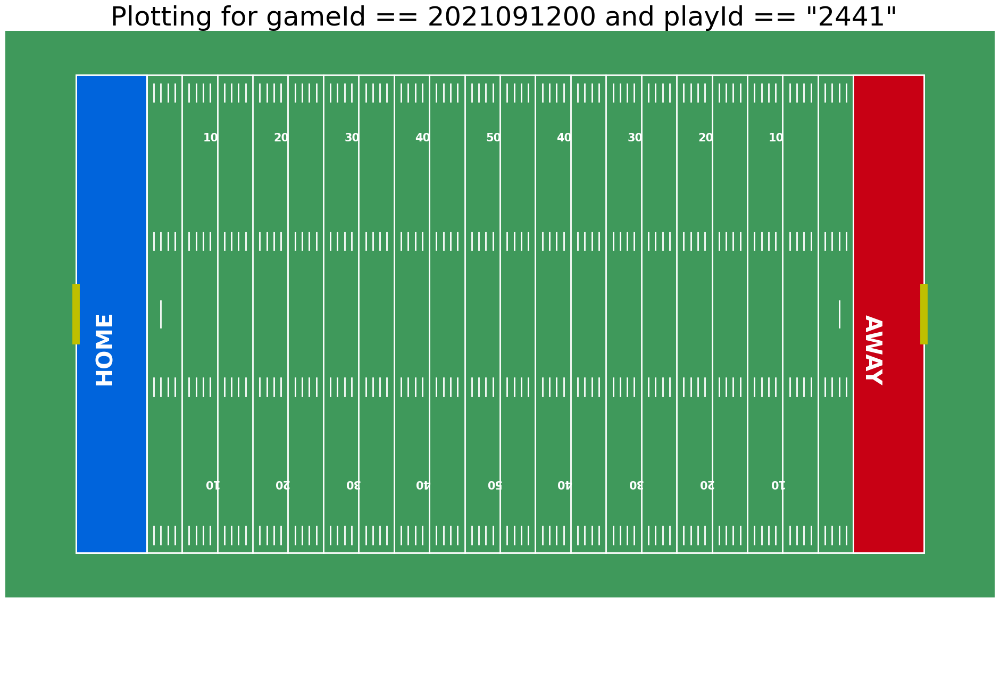

In [30]:
#fig, ax = plt.subplots(figsize=(12, 8))
fig, ax = drawPitch(100, 54)
ax.set_prop_cycle(custom_cycler)

print('Play Summary for gameId == 2021091200 and playId == 2441')
tracking2018.query('gameId == 2021091200 and playId == 2441').groupby('team') \
    .plot(x='x', y='y', ax=ax, style='.')
gameId = "2021091200"
playId = "2441"
plt.title(' Plotting for gameId == ' + gameId + ' and playId == "' + playId +  '"',fontsize=36,ha='center')
plt.legend().remove();


### <span class="title-section w3-large" style="color:#DC143C" id="codebook">4.8.6 Dynamic Pull down menu</span>
##### 
###### Code Inspired by https://www.kaggle.com/werooring/nfl-big-data-bowl-basic-eda-for-beginner

In [31]:
games_ids = {}
games_tracking2018 = tracking2018.groupby(by=["gameId"])
for game, data in games_tracking2018:
    games_ids[game] = list(set(data.playId.tolist()))

    

In [32]:
def extract_one_game(game_id, play_id, df):
    game = df[(df.gameId == game_id) & (df.playId == play_id)]
    home = {}
    away = {}
    balls = []
    
    players = game.sort_values(['frameId'], ascending=True).groupby('nflId')
    for id, dx in players:
        jerseyNumber = int(dx.jerseyNumber.iloc[0])
        if dx.team.iloc[0] == "home":
            home[jerseyNumber] = list(zip(dx.x.tolist(), dx.y.tolist()))
        elif dx.team.iloc[0] == "away":
            away[jerseyNumber] = list(zip(dx.x.tolist(), dx.y.tolist()))


    ball_df = game.sort_values(['frameId'], ascending=True) 
    ball_df = ball_df[ball_df.team == "football"]
    balls = list(zip(ball_df.x.tolist(), ball_df.y.tolist()))
    return home, away, balls

In [33]:
from matplotlib import animation
from IPython.display import HTML
def animate_one_play(game_id, play_id, df):
    fig, ax = drawPitch(100, 53.3)
    
    home, away, balls = extract_one_game(game_id, play_id, df)

    team_left, = ax.plot([], [], '>', markersize=15, markerfacecolor="r", markeredgewidth=2, markeredgecolor="white", zorder=7)
    team_right, = ax.plot([], [], '<', markersize=15, markerfacecolor="b", markeredgewidth=2, markeredgecolor="white", zorder=7)
    ball, = ax.plot([], [], 'o', markersize=20, markerfacecolor="black", markeredgewidth=2, markeredgecolor="white", zorder=7)
    drawings = [team_left, team_right, ball]

    def init():
        team_left.set_data([], [])
        team_right.set_data([], [])
        ball.set_data([], [])
        return drawings

    def draw_teams(i):
        X = []
        Y = []
        for k, v in home.items():
            x, y = v[i]
            X.append(x)
            Y.append(y)
        team_left.set_data(X, Y)
        
        X = []
        Y = []
        for k, v in away.items():
            x, y = v[i]
            X.append(x)
            Y.append(y)
        team_right.set_data(X, Y)

    def animate(i):
        draw_teams(i)
        
        x, y = balls[i]
        ball.set_data([x, y])
        return drawings
    
    # !May take a while!
    anim = animation.FuncAnimation(fig, animate, init_func=init,
                                   frames=len(balls), interval=100, blit=True)

    return anim


## <span class="title-section w3-xlarge" style="color:#DC143C" id="codebook">4.9 Animation for a play</span>


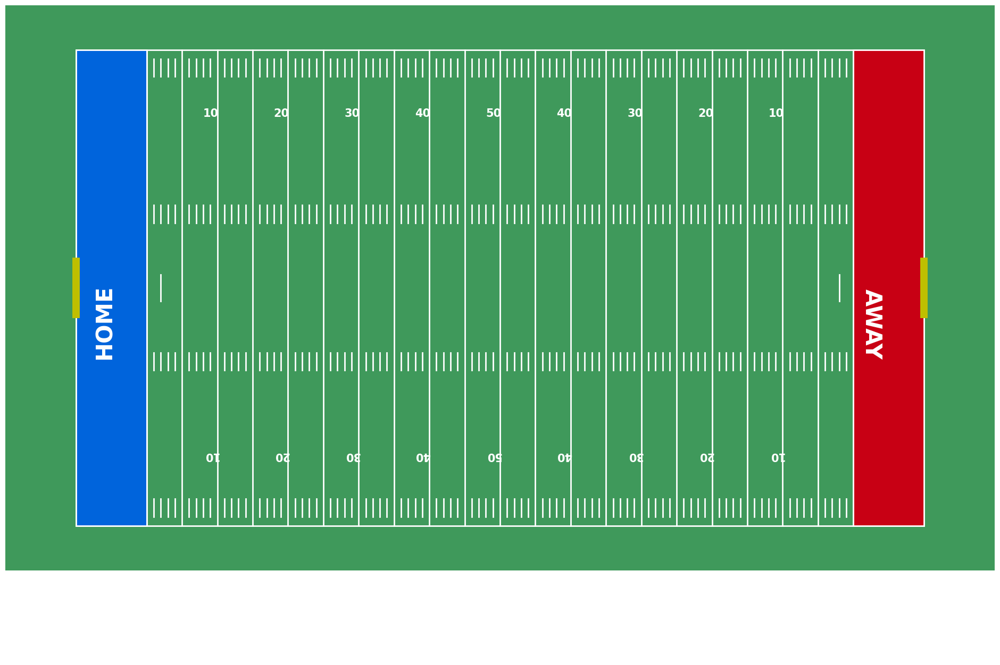

In [34]:
animate_one_play(2018121000, 2441, tracking2018)
gameid=2021090900
gamelist=(2021090900,2018121000,2018100704,2018111105,2018091610, 2018110401, 2018100701, 2018123005, 2018102102, 2018121606)
plays=(2441,241,324,3239,3871,2180,4281,993,1452,1977)


## <span class="title-section w3-xlarge" style="color:#DC143C" id="codebook">4.9.1 Select a game</span>


In [35]:
import ipywidgets as widgets
from ipywidgets import interactive

games = sorted(tracking2018['gameId'].unique().tolist())
#games = sorted(df['Asset Type Description'].unique().tolist())
 
def view(x=''):
    return tracking2018[tracking2018['gameId']==x]
 
w = widgets.Dropdown(options=games,	description='Game:',    disabled=False,)

interactive(view, x=w)

interactive(children=(Dropdown(description='Game:', options=(2021090900, 2021091200, 2021091201, 2021091202, 2…

In [36]:
gameid = w.value

In [37]:
import random

#games = sorted(tracking2018['gameId'].unique().tolist())
plays = sorted(tracking2018[tracking2018['gameId']==gameid]['playId'])



## <span class="title-section w3-xlarge" style="color:#DC143C" id="codebook">4.9.2 Random Play animation 1</span>

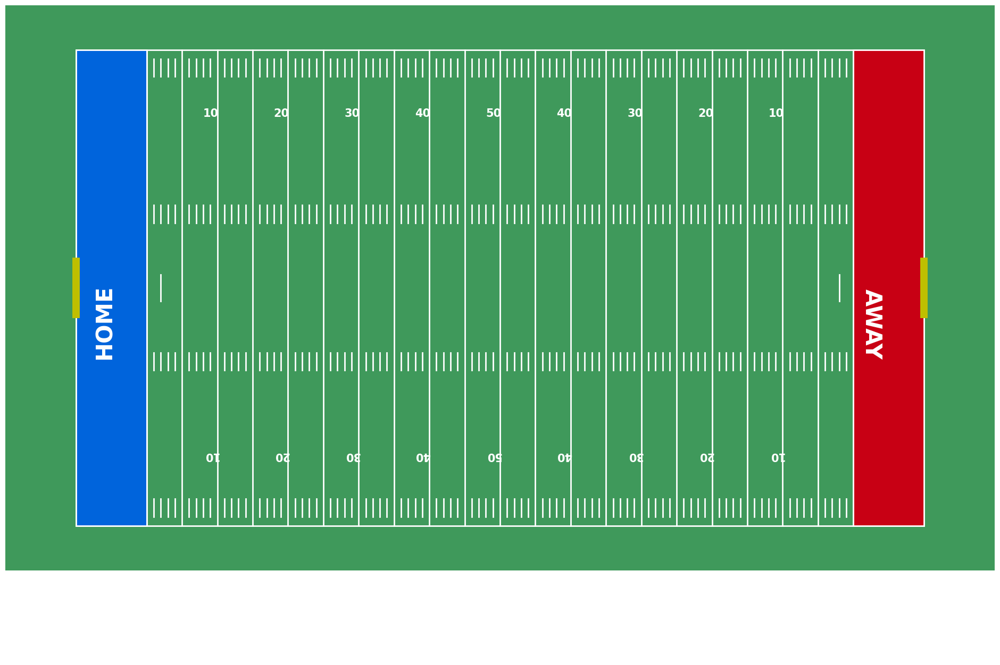

In [38]:
animate_one_play(2021091907, 1438, tracking2018)


## <span class="title-section w3-xlarge" style="color:#DC143C" id="codebook">4.9.3 Random Play animation 2</span>

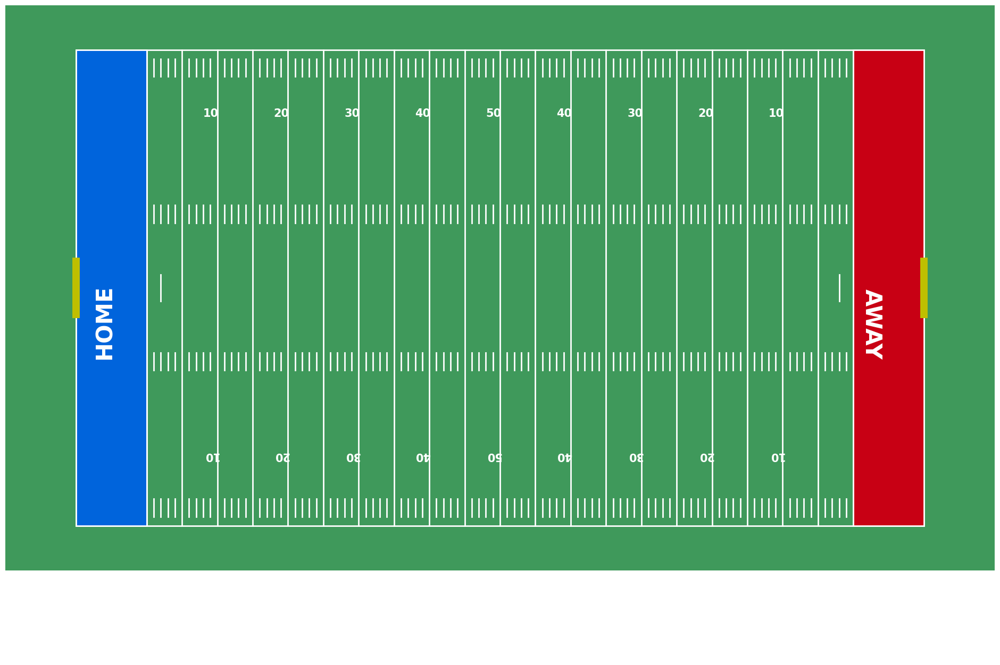

In [39]:
'''
gameid = 2018100704
playid = 3239
playid=random.choice(plays)
print('animation for ' , playid)
animate_one_play(gameid, plays[playid], tracking2018)
'''
animate_one_play(2021102500, 326, tracking2018)


## <span class="title-section w3-xlarge" style="color:#DC143C" id="codebook">4.9.4 Random Play animation 3</span>

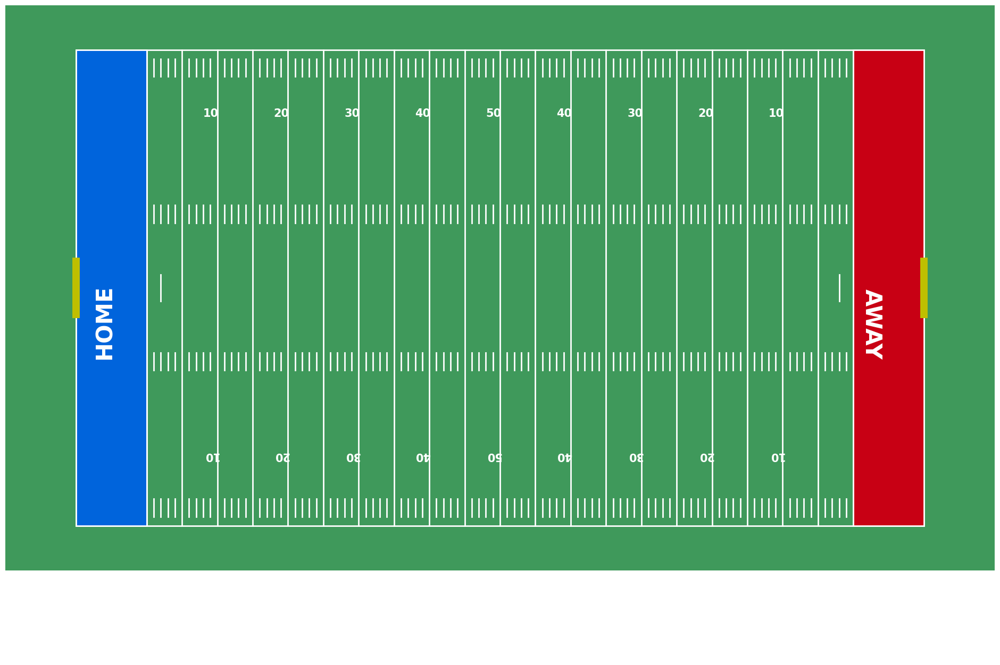

In [40]:
animate_one_play(2021102400, 2522, tracking2018)


## <span class="title-section w3-xlarge" style="color:#DC143C" id="codebook">4.9.5 Random Play animation 4</span>


## <span class="title-section w3-xlarge" style="color:#DC143C" id="codebook">4.9.6 Random Play animation 5</span>

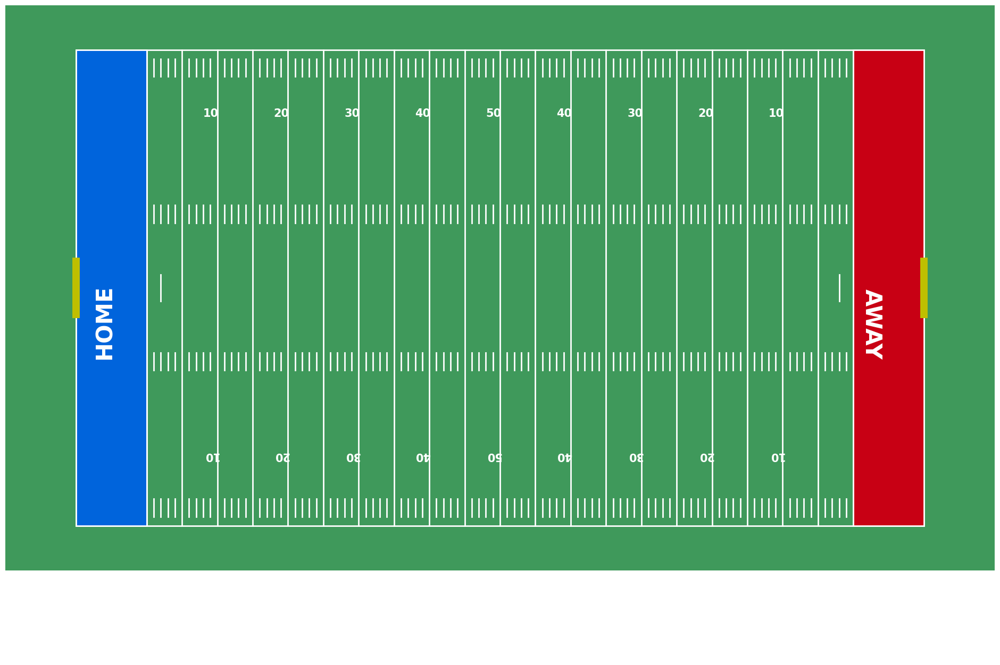

In [41]:
animate_one_play(2021091909, 1797, tracking2018)

In [43]:
import dill
dill.dump(create_report, open("/data/elastic-notebook/tmp/nfl_pickle/create_report4.pickle", "wb"))


# <span class="title-section w3-xxlarge" style="color:#DC143C" id="codebook">999. Work in Progress</span>

## <span class="title-section w3-xlarge" style="color:#DC143C" id="codebook">That's all folks! More will come later. Keep checking and keep learning</span>

![More to come](https://www.lambdatest.com/blog/wp-content/uploads/2019/11/giphy-2.gif)
